## Artificial intelligence 

### Project Four

### Hamidreza Khodadadi 810197499

### Imported libraries:

In [315]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder 
from sklearn.model_selection import train_test_split 
from sklearn.metrics import mean_squared_error 
from sklearn.metrics import mean_absolute_error
from sklearn.linear_model import LinearRegression 
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor 
from sklearn.ensemble import VotingRegressor

### Read csv file as data frame
We load this file for testing and training and statistical analysis.

In [392]:
data_frame = pd.read_csv("train.csv")
#pd.set_option('display.max_rows', None, 'display.max_columns', None)
display(data_frame)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,Gas

## Phase Zero: Visualization and EDA

### Question One:

### Describe
Pandas describe() method return statistical summary of data frame. We can give three argument (percentile, include, exclude) to this method which are none by default.

Pandas describe() is used to view some basic statistical details like percentile, mean, std,max, min, count of a data frame.

In [393]:
data_describe = data_frame.describe() 
display(data_describe)

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


### Info
Pandas info() method return brief summary of data frame. We can give five argument (verbose, buf, max_cols, memory_usage, null_counts) to this method which are none by default.

In [395]:
data_info = data_frame.info() 
display(data_info)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

None

### Question Two:

In [396]:
data_frame_null = data_frame.isnull() 
display(data_frame_null)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,False,False,False,False,False
1,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,False,False,False,False,False
2,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,False,False,False,False,False
3,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,False,False,False,False,False
4,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,False,False,False,False,False
5,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False

In [397]:
missing_data_count = data_frame.isnull().sum()
not_missing_data_count = data_frame.notnull().sum()
all_data_count = missing_data_count + not_missing_data_count
missing_values = missing_data_count / all_data_count * 100

missing_values = missing_values[missing_values != 0]
display(missing_values)

LotFrontage     17.739726
Alley           93.767123
MasVnrType       0.547945
MasVnrArea       0.547945
BsmtQual         2.534247
BsmtCond         2.534247
BsmtExposure     2.602740
BsmtFinType1     2.534247
BsmtFinType2     2.602740
Electrical       0.068493
FireplaceQu     47.260274
GarageType       5.547945
GarageYrBlt      5.547945
GarageFinish     5.547945
GarageQual       5.547945
GarageCond       5.547945
PoolQC          99.520548
Fence           80.753425
MiscFeature     96.301370
dtype: float64

These non values that we see in the above data are not definitely missing data, we view the data_description.txt file and calculate the percentage of missing data according to the definition of each type of data.

In [398]:
meaningful_nan = {"FireplaceQu", "GarageType", "MiscFeature", "GarageFinish", "Alley", "GarageCond", "PoolQC",
                  "BsmtExposure", "BsmtQual", "BsmtCond", "BsmtFinType1", "BsmtFinType2","Fence", "GarageQual"}

missing_data = data_frame.copy()
for i in missing_data:
    if i in meaningful_nan:
        missing_data = missing_data.drop([i], axis = 1)
                
missing_data_count = missing_data.isnull().sum()
not_missing_data_count = missing_data.notnull().sum()
all_data_count = missing_data_count + not_missing_data_count
missing_values = missing_data_count / all_data_count * 100

missing_values = missing_values[missing_values != 0]
display(missing_values)

LotFrontage    17.739726
MasVnrType      0.547945
MasVnrArea      0.547945
Electrical      0.068493
GarageYrBlt     5.547945
dtype: float64

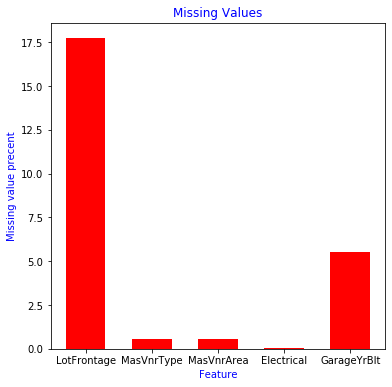

In [399]:
plt.figure(figsize = (6, 6)) 
plt.bar(missing_values.index, missing_values, color = 'red', width = 0.6) 

plt.title("Missing Values", color = 'blue') 
plt.xlabel("Feature", color = 'blue') 
plt.ylabel("Missing value precent", color = 'blue') 

plt.show() 

### Question Three:


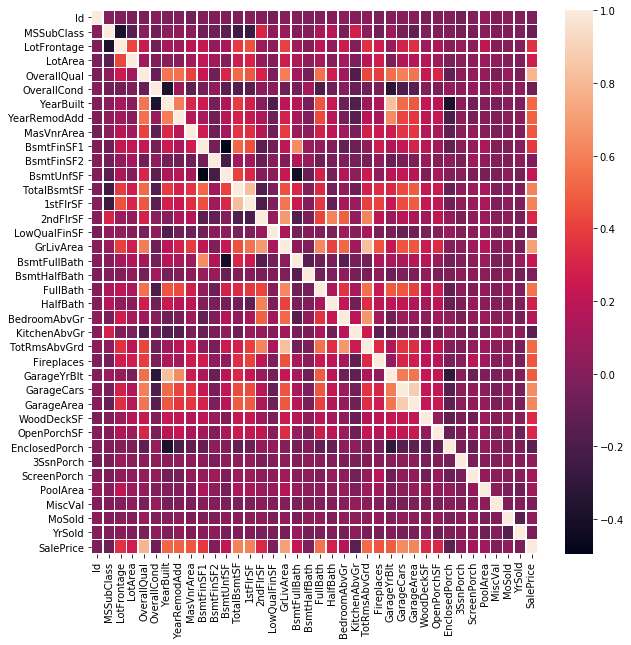

In [400]:
plt.figure(figsize = (10, 10))
data_heatmap = sns.heatmap(data_frame.corr(), linewidths = 0.5)
plt.show()

According to the above heat diagram, which is plotted for the degree of dependence of the properties on each other, the darker color of a house, the more dependent the two properties are on each other.

Now below, for the house price estimation feature (SalePrice), the sorted value of 10 of the maximum values for the degree of data interdependence is given.

We choose the first 4 values:

1. OverallQual
2. GrLiveArea
3. GarageCars
4. GarageArea
5. TotalBsmtSF

In [401]:
data_frame_corr = data_frame.corr()['SalePrice'].sort_values(ascending = False)[1:10]
display(data_frame_corr)

OverallQual     0.790982
GrLivArea       0.708624
GarageCars      0.640409
GarageArea      0.623431
TotalBsmtSF     0.613581
1stFlrSF        0.605852
FullBath        0.560664
TotRmsAbvGrd    0.533723
YearBuilt       0.522897
Name: SalePrice, dtype: float64

### Question Four:

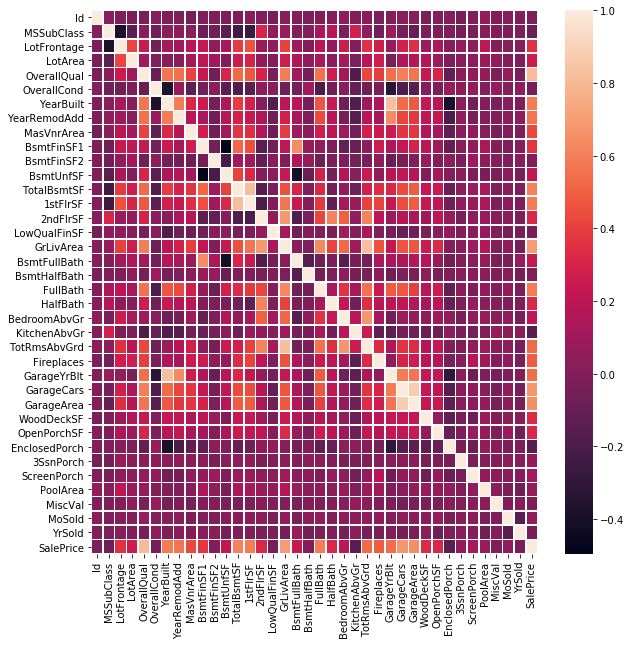

In [402]:
plt.figure(figsize = (10, 10))
data_frame_log = data_frame.copy()
data_frame_log['SalePrice'] = np.log(data_frame_log['SalePrice'])
data_heatmap = sns.heatmap(data_frame_log.corr(), linewidths = 0.5)
plt.show()

It is possible that the dependence of the two properties to each other has been exponential, then when we take logarithms from them, their dependence will be linear.

We see that we increase the amount of dependence of some properties on each other, which is due to the linearity of the degree of dependence of those two properties on each other.

In [403]:
data_frame_log_corr = data_frame_log.corr()['SalePrice'].sort_values(ascending = False)[1:10]
display(data_frame_log_corr)

OverallQual     0.817184
GrLivArea       0.700927
GarageCars      0.680625
GarageArea      0.650888
TotalBsmtSF     0.612134
1stFlrSF        0.596981
FullBath        0.594771
YearBuilt       0.586570
YearRemodAdd    0.565608
Name: SalePrice, dtype: float64

/usr/lib/python3/dist-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
/usr/lib/python3/dist-packages/matplotlib/axes/_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
/usr/lib/python3/dist-packages/matplotlib/axes/_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


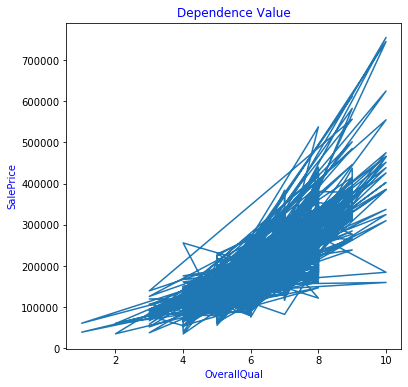

In [404]:
plt.figure(figsize = (6, 6)) 
plt.plot(data_frame['OverallQual'], data_frame['SalePrice']) 

plt.title("Dependence Value", color = 'blue') 
plt.xlabel("OverallQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show()

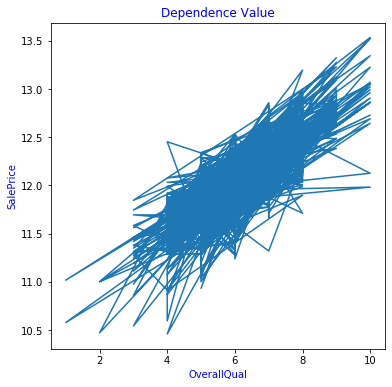

In [405]:
plt.figure(figsize = (6, 6)) 
plt.plot(data_frame['OverallQual'], np.log(data_frame['SalePrice'])) 

plt.title("Dependence Value", color = 'blue') 
plt.xlabel("OverallQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show()

### Question Five:

In the third question, we do not consider the categorical values, while the correlation is not defined for the categorical data. 

In addition, in the third question, we consider only the dependence of two properties on each other, but this dependence of those two properties may be due to the dependence of those two properties on other properties, so in the third question, accuracy our conclusion will not be appropriate. 

In addition, the two features we select in the third question may conceptually point to the same subject, in which case selecting both does not give us new information.

### Question Six:

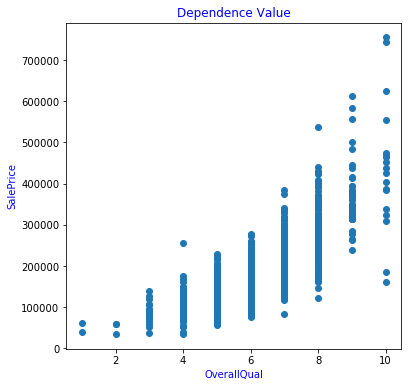

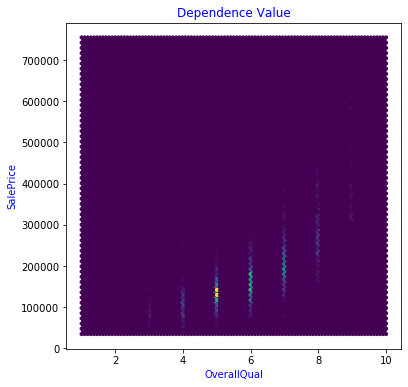

In [406]:
plt.figure(figsize = (6, 6))
plt.scatter(data_frame['OverallQual'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("OverallQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

plt.figure(figsize = (6, 6))
plt.hexbin(data_frame['OverallQual'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("OverallQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

For these two attributes, SalePrice and OverallQual, the dependence is roughly straightforward, and the higher the OverallQual variable, the higher the SalePrice value.

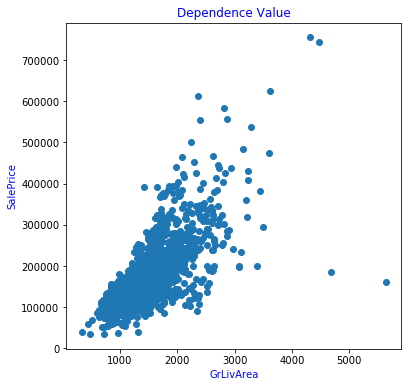

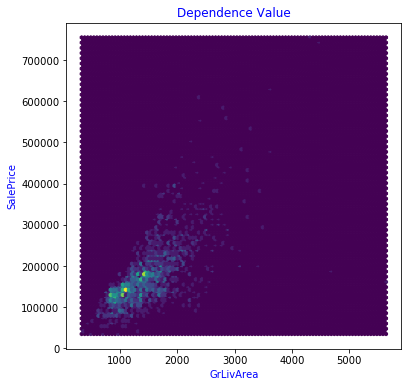

In [407]:
plt.figure(figsize = (6, 6))
plt.scatter(data_frame['GrLivArea'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GrLivArea", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

plt.figure(figsize = (6, 6))
plt.hexbin(data_frame['GrLivArea'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GrLivArea", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

For these two attributes, SalePrice and GrLivArea, the dependence is roughly straightforward, and the higher the GrLivArea variable, the higher the SalePrice value.

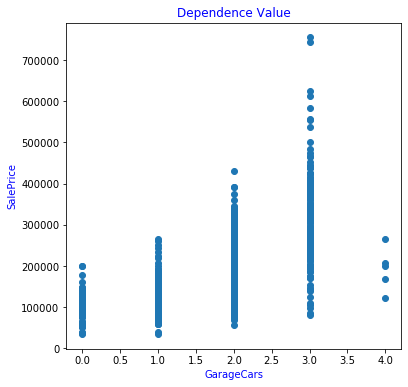

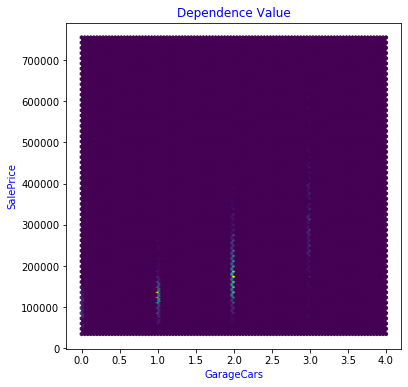

In [408]:
plt.figure(figsize = (6, 6))
plt.scatter(data_frame['GarageCars'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GarageCars", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

plt.figure(figsize = (6, 6))
plt.hexbin(data_frame['GarageCars'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GarageCars", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

For these two attributes, SalePrice and GarageCars, the dependence is roughly straightforward, and the higher the GarageCars variable, the higher the SalePrice value.

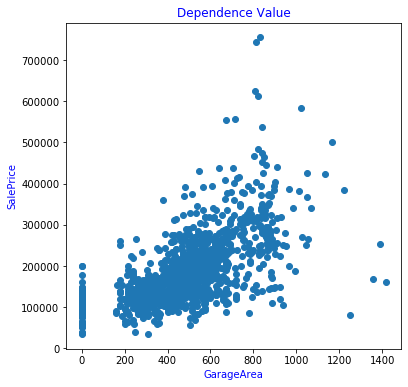

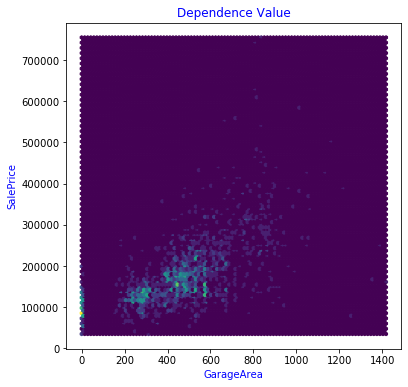

In [409]:
plt.figure(figsize = (6, 6))
plt.scatter(data_frame['GarageArea'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GarageArea", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

plt.figure(figsize = (6, 6))
plt.hexbin(data_frame['GarageArea'], data_frame['SalePrice'])
plt.title("Dependence Value", color = 'blue') 
plt.xlabel("GarageArea", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 
plt.show()

For these two attributes, SalePrice and GarageArea, the dependence is roughly straightforward, and the higher the GarageArea variable, the higher the SalePrice value.

### Question Seven:

I viewed the data_description.txt file and we select the following categorized features to draw the plots.

1. Neighborhood
2. Utilities
3. KitchenQual
4. ExterQual
5. Exterior1st
6. SaleCondition


In [410]:
plt.figure(figsize = (25, 15)) 
plt.bar(data_frame["Neighborhood"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("Neighborhood", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() FireplaceQ

SyntaxError: invalid syntax (<ipython-input-410-140cbce1da03>, line 8)

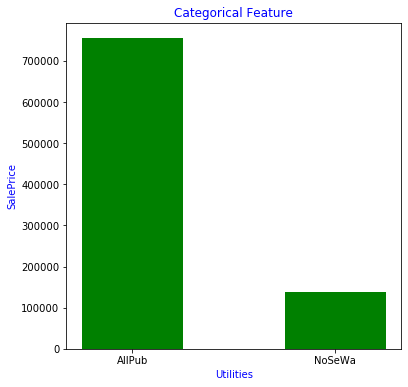

In [411]:
plt.figure(figsize = (6, 6)) 
plt.bar(data_frame["Utilities"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("Utilities", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() 

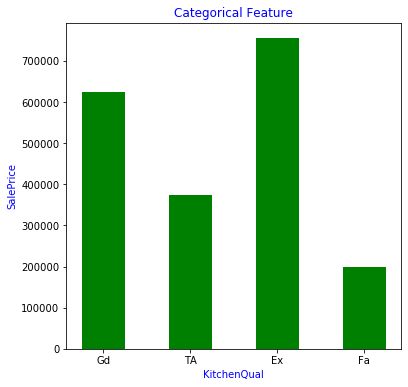

In [412]:
plt.figure(figsize = (6, 6)) 
plt.bar(data_frame["KitchenQual"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("KitchenQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() 

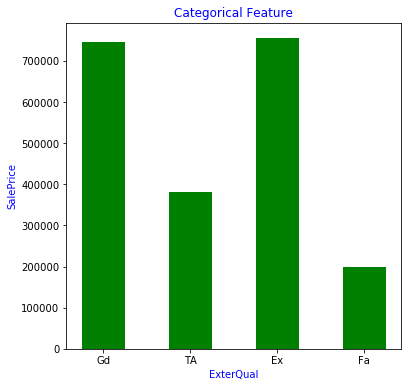

In [413]:
plt.figure(figsize = (6, 6)) 
plt.bar(data_frame["ExterQual"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("ExterQual", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() 

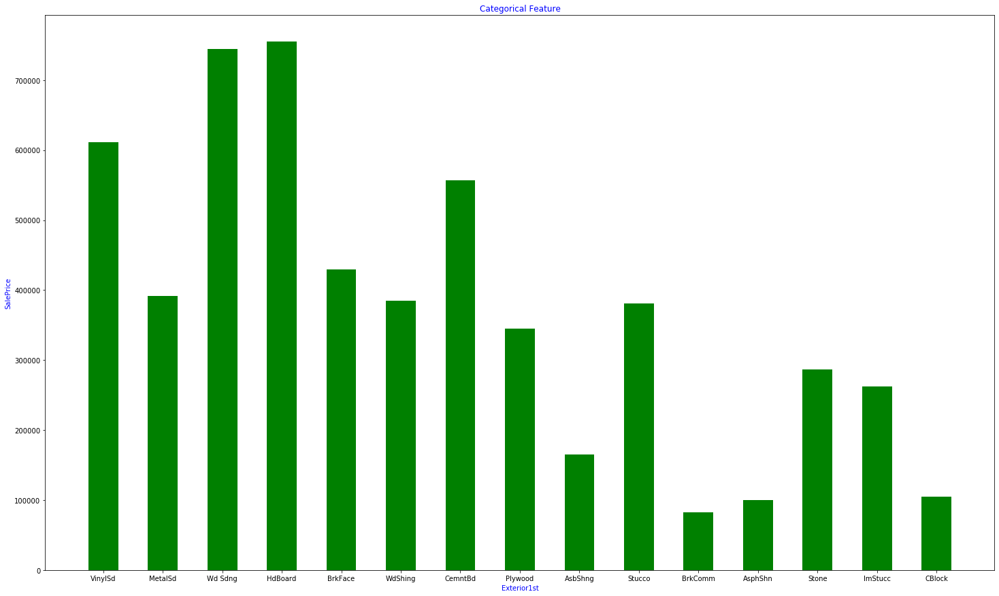

In [414]:
plt.figure(figsize = (25, 15)) 
plt.bar(data_frame["Exterior1st"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("Exterior1st", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() 

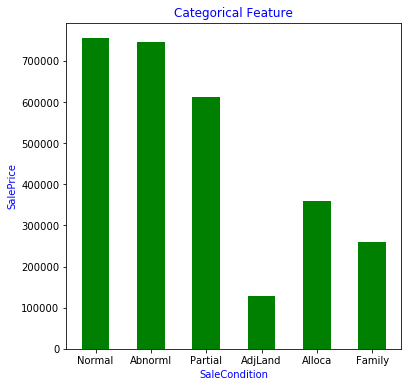

In [415]:
plt.figure(figsize = (6, 6)) 
plt.bar(data_frame["SaleCondition"], data_frame["SalePrice"], color = 'green', width = 0.5) 

plt.title("Categorical Feature", color = 'blue') 
plt.xlabel("SaleCondition", color = 'blue') 
plt.ylabel("SalePrice", color = 'blue') 

plt.show() 

## Phase One:

### Question One:

Deleting data: 
This method can be used more when the data set is a large set, but in a small data set reduces the accuracy and that we can handle our processing operations with respect to the remaining data. 
And delete this data does not cause more damage to the original data. 
And that we usually use delete a feature when there is a lot of data lost from that feature. Because we are finally losing useful data, so we have to decide whether to delete or not to do more.

Replacement with statistical data: 
In this method, depending on the type of statistical data and how the values are distributed in that data, the lost values are filled with values such as average or median. 
The positive feature of this method is that it does not add any specific information to our training index. However, the disadvantages of this method are the increase in the amount of data variance and data bias. 
And that it also distorts statistical graphs. 
And that this method is used when the lost data is numerical data, then this method will be more useful than the method of deleting that data.

Predicting lost data: 
We can consider lost data as the target column and other data as training data. That is, according to other features that we have, we predict that feature is lost. Using this method increases the accuracy of our data, but in large data sets this method will be time consuming. 

Recover lost values: 
If lost data is very important, you can access the original resources and recover that data. For example, he went to a mobile phone manufacturer and recovered the lost information. 

Guessing lost data: 
In some cases, this method may be more useful than deleting that data.

In general, a general approach and the use of several methods can be used to handle the lost data.

### Question Two:
As mentioned earlier, the non values of the list below do not mean lost data, but have another meaning that can be seen in the data_description.txt file. 

{"FireplaceQu", "GarageType", "MiscFeature", "GarageFinish", "Alley", "GarageCond", "PoolQC",
 "BsmtExposure", "BsmtQual", "BsmtCond", "BsmtFinType1", "BsmtFinType2","Fence", "GarageQual"}

We need to look at other issues to remove the lost data column, as mentioned earlier. As if deleting that data column did not delete any other necessary information, then we can replace that lost data with the said methods. 

In this section, we fill in the missing data with the middle of that data.

The following features have the most data lost. 

In [416]:
display(missing_values)

LotFrontage    17.739726
MasVnrType      0.547945
MasVnrArea      0.547945
Electrical      0.068493
GarageYrBlt     5.547945
dtype: float64

In [417]:
def handle_missing_data_with_drop(data_frame):
    data_frame_temp = data_frame.copy()
    data_frame_temp = data_frame_temp.drop("LotFrontage", axis = 1)
    data_frame_temp = data_frame_temp.drop("MasVnrType", axis = 1)
    data_frame_temp = data_frame_temp.drop("MasVnrArea", axis = 1)
    data_frame_temp = data_frame_temp.drop("Electrical", axis = 1)
    data_frame_temp = data_frame_temp.drop("GarageYrBlt", axis = 1)
    return data_frame_temp

data_frame_temp = handle_missing_data_with_drop(data_frame)    
display(data_frame_temp)

,Id,MSSubClass,MSZoning,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,TA,Attchd,RFn,1,205,Gd,TA,Y,0,4,0,0,0,0,NaN,NaN,NaN,0,1,2008,WD,Normal,118000


In [418]:
def handle_missing_data_with_mean(data_frame):
    data_frame_temp = data_frame.copy()
    data_frame_temp["MasVnrType"] = data_frame_temp["MasVnrType"].fillna(data_frame_temp["MasVnrType"].mode())
    data_frame_temp["Electrical"] = data_frame_temp["Electrical"].fillna(data_frame_temp["Electrical"].mode())
    data_frame_temp["LotFrontage"] = data_frame_temp["LotFrontage"].fillna(data_frame_temp["LotFrontage"].mean())
    data_frame_temp["MasVnrArea"] = data_frame_temp["MasVnrArea"].fillna(data_frame_temp["MasVnrArea"].mean())
    data_frame_temp["GarageYrBlt"] = data_frame_temp["GarageYrBlt"].fillna(data_frame_temp["GarageYrBlt"].mean())
    return data_frame_temp

data_frame_temp = handle_missing_data_with_mean(data_frame)    
display(data_frame_temp)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.000000,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.000000,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.000000,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.000000,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.000000,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.000000,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.000000,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.000000,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.000000,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.000000,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.000000,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.000000,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.000000,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.000000,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.000000,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.000000,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.000000,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.000000,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.000000,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.000000,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,70.049958,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.000000,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.000000,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.000000,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.000000,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.000000,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.000000,7420,Pave,NaN,Reg,Lvl,AllPub,Corner

In [419]:
def handle_missing_data_with_median(data_frame):
    data_frame_temp = data_frame.copy()
    data_frame_temp["MasVnrType"] = data_frame_temp["MasVnrType"].fillna(data_frame_temp["MasVnrType"].mode())
    data_frame_temp["Electrical"] = data_frame_temp["Electrical"].fillna(data_frame_temp["Electrical"].mode())
    data_frame_temp["LotFrontage"] = data_frame_temp["LotFrontage"].fillna(data_frame_temp["LotFrontage"].median())
    data_frame_temp["MasVnrArea"] = data_frame_temp["MasVnrArea"].fillna(data_frame_temp["MasVnrArea"].median())
    data_frame_temp["GarageYrBlt"] = data_frame_temp["GarageYrBlt"].fillna(data_frame_temp["GarageYrBlt"].median())
    return data_frame_temp

data_frame_temp = handle_missing_data_with_median(data_frame)
display(data_frame_temp)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,69.0,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,Ga

### Question Three:

Both of these methods are used to scale the data. 
Normalization changes the data so that they are all in the range between zero and one and on a common scale. Standardization assumes that our data follows a Gaussian distribution. 
In this method, the data is changed so that the average of the data is equal to 0 and the variance of the data is equal to 1. 
These two actions may increase the effectiveness of optimization methods. 
These two methods are useful when we need our data to be on the same scale. 
These two methods will usually be used in machine learning algorithms.

In [420]:
def normalization(data_frame):
    noramlized_data_frame = data_frame.copy()
    normalizer = preprocessing.Normalizer()                                                            
    noramlized_data_frame = normalizer.fit_transform(noramlized_data_frame)
    return pd.DataFrame(noramlized_data_frame)
    
def standardizing(data_frame):
    standard_data_frame = data_frame.copy()
    scaler = preprocessing.StandardScaler() 
    standard_data_frame = scaler.fit_transform(standard_data_frame) 
    return pd.Dateframe(standard_data_frame)

### Question Four:

There are several ways to categorize, which are summarized below. And not all of this data can be handled in one way. And according to the type of data should be handled. 

Binary: In this method, only 2 values of zero and one or true and false can be attributed to classified attributes. 

Ordinal: In this method, classified attributes can take different values but in order. For example, if we have n attributes, we can assign them numbers from one to n. 

Nominal: In this method, classified traits can take different values that are out of order. And attributes will have no numerical value. One-hot can be used for encryption in this method. Like good and evil

In [421]:
def handle_categorical_data():   
    label_encoder = LabelEncoder()  

    data_frame_categorical = data_frame.select_dtypes(include = ['object'])
    data_frame_not_categorical = data_frame.select_dtypes(exclude = ['object'])
    
    for i in data_frame_categorical:
        data_frame_categorical[i] = label_encoder.fit_transform(data_frame_categorical[i].astype(str))
    
    new_data_frame = pd.concat([data_frame_categorical, data_frame_not_categorical], axis = 1)  
    return new_data_frame

new_data_frame = handle_categorical_data()

<ipython-input-421-48d70ed29898>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_frame_categorical[i] = label_encoder.fit_transform(data_frame_categorical[i].astype(str))


### Question Five:

We can delete columns that do not provide much information about our target column. 
We can also delete columns that have a high amount of lost data and therefore do not provide us with useful information about the target column.
We can also remove columns that have a low correlation with the target column according to the third question from phase zero. 
Or we can even remove some features that are highly correlated with each other and do not give us new information about the target column.

### Question Six:

What percentage of data we use for training and what percentage of data we use for testing depends on our purpose for the project. 
Another point is the size of our data. If the data is small, then if the amount of training data is low, our model will not work well and will have a high error rate.
And in general there should be a correlation between the size of the training data and the test data, if the training data is smaller than a certain level then the model will not be well constructed and will have a lot of error, If it is a little smaller, then our model will not be well evaluated. 
Also, our data should not be sorted and should not have a special order to prevent the creation of biased models or biased testing. As a result, in this case, the data needs to be randomly distributed.

In [422]:
def split_data_to_train_test(data_frame):
    x = data_frame.drop(["SalePrice"], axis = 1)
    y = data_frame["SalePrice"]
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state = 20)    
    return x_train, x_test, y_train, y_test

### Phase Two:

### Question One:

In this section, I have done various preprocessions on the data and shown the effect of the performance of the accuracy stated in the question for the 3 models made.

In [423]:
def evaluation_of_models(x_train, y_train, x_test, y_test, n_neighbors, max_depth):
    k_nearest_neighbor(x_train, y_train, x_test, y_test, n_neighbors, False, True)
    print()
    decision_tree(x_train, y_train, x_test, y_test, max_depth, False, True)
    print()
    linear_regression(x_train, y_train, x_test, y_test)
    print()
    
def accuracy_calculation(y_test, y_predict):
    rmse = mean_squared_error(y_test, y_predict, squared = False)
    mae = mean_absolute_error(y_test, y_predict)
    return rmse, mae

def k_nearest_neighbor(x_train, y_train, x_test, y_test, n, flag, print_flag): 
    knn = KNeighborsRegressor(n_neighbors = n) 
    param_grid = {'n_neighbors': [1, 300]}
    
    if flag == True:
        knn = GridSearchCV(KNeighborsRegressor(), param_grid)

    knn.fit(x_train, y_train) 
    y_predict = knn.predict(x_test)
    rmse, mae = accuracy_calculation(y_test, y_predict)
    if print_flag == True:
        print("K Nearest Neighbor Algorithm:")
        print("RMSE accuracy: ", rmse)
        print("MAE accuracy: ", mae)
    return rmse, mae

def decision_tree(x_train, y_train, x_test, y_test, n, flag, print_flag): 
    dtr = DecisionTreeRegressor(max_depth = n) 
    param_grid = {'max_depth': [1, 200]}

    if flag == True:
        dtr = GridSearchCV(DecisionTreeRegressor(), param_grid)
        
    dtr.fit(x_train, y_train) 
    y_predict = dtr.predict(x_test)
    rmse, mae = accuracy_calculation(y_test, y_predict)
    if print_flag == True:
        print("Decision Tree Algorithm:")
        print("RMSE accuracy: ", rmse)
        print("MAE accuracy: ", mae)
    return rmse, mae

def linear_regression(x_train, y_train, x_test, y_test): 
    lr = LinearRegression()
    lr.fit(x_train, y_train) 
    y_predict = lr.predict(x_test)
    rmse, mae = accuracy_calculation(y_test, y_predict)
    print("Linear Regression Algorithm:")
    print("RMSE accuracy: ", rmse)
    print("MAE accuracy: ", mae)
    return rmse, mae

In [424]:
print("Droping Missing Data: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_drop(new_data_frame))
evaluation_of_models(x_train, y_train, x_test, y_test, 5, 5)

print("Fill Missing Data With Mean: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
evaluation_of_models(x_train, y_train, x_test, y_test, 5, 5)

print("Fill Missing Data With Median: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_median(new_data_frame))
evaluation_of_models(x_train, y_train, x_test, y_test, 5, 5)

Droping Missing Data: 

K Nearest Neighbor Algorithm:
RMSE accuracy:  46316.413587847535
MAE accuracy:  29309.963470319635

Decision Tree Algorithm:
RMSE accuracy:  38927.82594542025
MAE accuracy:  26351.523573124436

Linear Regression Algorithm:
RMSE accuracy:  35084.5544399878
MAE accuracy:  19352.195320775503

Fill Missing Data With Mean: 

K Nearest Neighbor Algorithm:
RMSE accuracy:  46070.46311686254
MAE accuracy:  28876.193607305937

Decision Tree Algorithm:
RMSE accuracy:  39184.56685077343
MAE accuracy:  26560.651163570514

Linear Regression Algorithm:
RMSE accuracy:  36649.2201684675
MAE accuracy:  20183.389421187287

Fill Missing Data With Median: 

K Nearest Neighbor Algorithm:
RMSE accuracy:  46044.51917689461
MAE accuracy:  28889.11598173516

Decision Tree Algorithm:
RMSE accuracy:  43145.03323061243
MAE accuracy:  27191.940103195073

Linear Regression Algorithm:
RMSE accuracy:  36660.353203598934
MAE accuracy:  20175.094064661782



### Question Two:

### K Nearest Neighbor:

In [425]:
print("K Nearest Neighbor With GridSearch: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
k_nearest_neighbor(x_train, y_train, x_test, y_test, 5, True, True)

K Nearest Neighbor With GridSearch: 

K Nearest Neighbor Algorithm:
RMSE accuracy:  54878.44527837166
MAE accuracy:  36385.691780821915


(54878.44527837166, 36385.691780821915)

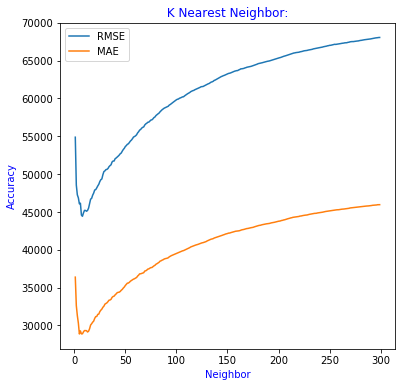

In [426]:
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
rmse = list()
mae = list()
for i in range(1, 300):
    a, b = k_nearest_neighbor(x_train, y_train, x_test, y_test, i, False, False)
    rmse.append(a)
    mae.append(b)
    
plt.figure(figsize = (6, 6)) 
plt.title(" K Nearest Neighbor: ", color = "blue")
plt.plot([i for i in range(1, 300)], rmse, label = "RMSE")
plt.plot([i for i in range(1, 300)], mae, label = "MAE")
plt.xlabel("Neighbor", color = "blue", size = 10)
plt.ylabel("Accuracy", color = "blue", size = 10)
plt.legend()
plt.show() 

### Decision Tree:

In [431]:
print("Decision Tree With GridSearch: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_drop(new_data_frame))
decision_tree(x_train, y_train, x_test, y_test, 5, True, True)

Decision Tree With GridSearch: 

Decision Tree Algorithm:
RMSE accuracy:  44022.53952930918
MAE accuracy:  27623.869863013697


(44022.53952930918, 27623.869863013697)

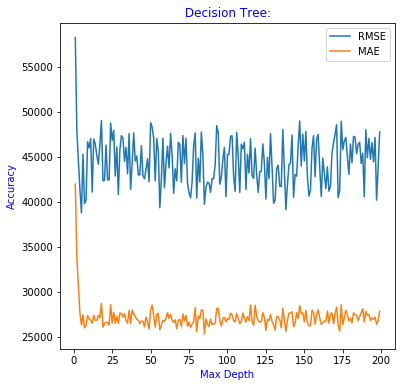

In [432]:
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
rmse = list()
mae = list()
for i in range(1, 200):
    a, b = decision_tree(x_train, y_train, x_test, y_test, i, False, False)
    rmse.append(a)
    mae.append(b)
    
plt.figure(figsize = (6, 6)) 
plt.title(" Decision Tree: ", color = "blue")
plt.plot([i for i in range(1, 200)], rmse, label = "RMSE")
plt.plot([i for i in range(1, 200)], mae, label = "MAE")
plt.xlabel("Max Depth", color = "blue", size = 10)
plt.ylabel("Accuracy", color = "blue", size = 10)
plt.legend()
plt.show()

### Question Three:

Overfitting: 
This phenomenon occurs when our model is well trained on train data and even handles noise data well. As soon as this model counts the noise data in its data and is trained on it, it does not work well on the new data. As a result, this model does not work well on test data. 
The model has a high variance in this case. 

Underfitting: In this case, our model gives incorrect results on both train data and test data. In this case, our model is wrong. Various reasons such as lack of data, high noise data, wrong choice of model type and… can cause the wrong model to be made. 
In this case, the model uses low varinas and high bias.

We now evaluate our built models with different train and test data modes to determine if our models are overfitting or underfitting.

K Nearest Neighbor:

In [433]:
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
k_nearest_neighbor(x_train, y_train, x_test, y_test, 5, False, True)
print()
k_nearest_neighbor(x_train, y_train, x_train, y_train, 5, False, True)

K Nearest Neighbor Algorithm:
RMSE accuracy:  46070.46311686254
MAE accuracy:  28876.193607305937

K Nearest Neighbor Algorithm:
RMSE accuracy:  38911.461603205425
MAE accuracy:  24814.36457925636


(38911.461603205425, 24814.36457925636)

Decision Tree:

In [434]:
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
decision_tree(x_train, y_train, x_test, y_test, 5, False, True)
print()
decision_tree(x_train, y_train, x_train, y_train, 5, False, True)

Decision Tree Algorithm:
RMSE accuracy:  39184.56685077343
MAE accuracy:  26560.651163570514

Decision Tree Algorithm:
RMSE accuracy:  28087.99000559116
MAE accuracy:  20888.687403992582


(28087.99000559116, 20888.687403992582)

Linear Regression:

In [435]:
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
linear_regression(x_train, y_train, x_test, y_test)
print()
linear_regression(x_train, y_train, x_train, y_train)

Linear Regression Algorithm:
RMSE accuracy:  36649.2201684675
MAE accuracy:  20183.389421187287

Linear Regression Algorithm:
RMSE accuracy:  29099.430626068253
MAE accuracy:  18759.8244137666


(29099.430626068253, 18759.8244137666)

### Question Four:

In question one of this phase, we evaluate the effect of the preprocessors used on the three models.

## Phase Three:

### Question One:

In [436]:
def random_forest(x_train, y_train, x_test, y_test, flag): 
    rf = RandomForestRegressor()
    param_grid = {'max_depth': [5, 50],'n_estimators': [5, 300]}
    
    if flag == True:
        rf = GridSearchCV(rf, param_grid)
        
    rf.fit(x_train, y_train) 
    y_predict = rf.predict(x_test)
    rmse, mae = accuracy_calculation(y_test, y_predict)
    print("Random Forest Algorithm:")
    print("RMSE accuracy: ", rmse)
    print("MAE accuracy: ", mae)
    return rmse, mae

x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_drop(new_data_frame))

print("Without GridSearch: ")
print()
random_forest(x_train, y_train, x_test, y_test, False)

print()

print("With GridSearch: ")
print()
random_forest(x_train, y_train, x_test, y_test, True)

Without GridSearch: 

Random Forest Algorithm:
RMSE accuracy:  30479.4635077209
MAE accuracy:  17616.840958904108

With GridSearch: 

Random Forest Algorithm:
RMSE accuracy:  30232.951557742097
MAE accuracy:  17391.37823439878


(30232.951557742097, 17391.37823439878)

### Question Two:

In [437]:
def voting_regression(x_train, y_train, x_test, y_test): 
    vr = VotingRegressor([('knn', KNeighborsRegressor()), ('dt', DecisionTreeRegressor()),
                          ('lr',LinearRegression())])
    vr.fit(x_train, y_train) 
    y_predict = vr.predict(x_test)
    rmse, mae = accuracy_calculation(y_test, y_predict)
    print("Voting regression Algorithm:")
    print("RMSE accuracy: ", rmse)
    print("MAE accuracy: ", mae)
    return rmse, mae

print("Voting regression: ")
print()
x_train, x_test, y_train, y_test = split_data_to_train_test(handle_missing_data_with_mean(new_data_frame))
voting_regression(x_train, y_train, x_test, y_test)

Voting regression: 

Voting regression Algorithm:
RMSE accuracy:  35801.10323909346
MAE accuracy:  19235.0705925629


(35801.10323909346, 19235.0705925629)

### Question Three:

The voting regression method works by taking several models and combining them.
As a result, ideally, the result of using this method has a better output than the sum of the received methods. This method may correct the prediction defects in one model by accurately predicting other models. Or one model may not output well for part of the data and another model may output better for that part of the data. 
As a result, this method maintains the good results of each model and corrects the shortcomings of one model with better output of the other model.
